<a href="https://colab.research.google.com/github/astrrr/ML-Lab/blob/main/model_6.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import matplotlib.pyplot as plt
import cv2
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.applications.inception_v3 import InceptionV3
import pandas as pd
from tensorflow.keras.applications import DenseNet121
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications import NASNetMobile
from tensorflow.keras.applications import VGG19
from tensorflow.keras.applications import ResNet152V2



# Preprocessing data




In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
CWD = os.getcwd().replace('\\','/') # get current workspace directory

In [ ]:
train = ImageDataGenerator(rescale= 1/255)
validation = ImageDataGenerator(rescale= 1/255)

In [ ]:
train_dataset = train.flow_from_directory("/content/drive/MyDrive/data_fix_angle_augmented/train",
                                          target_size=(224,224),
                                          batch_size = 32,
                                          class_mode ="categorical")

validation_dataset = validation.flow_from_directory("/content/drive/MyDrive/data_fix_angle_augmented/validation",
                                          target_size=(224,224),
                                          batch_size = 32,
                                          class_mode ="categorical")

Found 15393 images belonging to 2 classes.
Found 3297 images belonging to 2 classes.




*   Class indice



In [ ]:
train_dataset.class_indices

{'correct': 0, 'incorrect': 1}

In [ ]:
validation_dataset.class_indices

{'correct': 0, 'incorrect': 1}

# Setup Model

In [ ]:
NNM = VGG19(
    include_top=False,
    weights="imagenet",
    
    input_shape=(224,224,3),
    pooling='max',
   
    classifier_activation="softmax")
NNM.trainable = False

80150528/80134624 [==============================] - 1s 0us/step


In [ ]:
model = tf.keras.models.Sequential([
                                    NNM,
                                    tf.keras.layers.Flatten(),
                                    tf.keras.layers.Dense(512, activation='relu'),
                                    tf.keras.layers.Dropout(0.6),
                                    tf.keras.layers.Dense(128, activation='relu'),
                                    tf.keras.layers.Dropout(0.4),
                                    tf.keras.layers.Dense(64, activation='relu'),
                                    tf.keras.layers.Dropout(0.5),
                                   
                                    tf.keras.layers.Dense(2, activation='softmax')
                                    
                                    
])

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg19 (Functional)          (None, 512)               20024384  
                                                                 
 flatten (Flatten)           (None, 512)               0         
                                                                 
 dense (Dense)               (None, 512)               262656    
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_1 (Dense)             (None, 128)               65664     
                                                                 
 dropout_1 (Dropout)         (None, 128)               0         
                                                                 
 dense_2 (Dense)             (None, 64)                8

In [ ]:
opt = tf.keras.optimizers.Adam(learning_rate=0.00005, name='Adam') 
los = tf.keras.losses.binary_crossentropy 
  

model.compile(optimizer=opt, loss=los, metrics=['accuracy'])

In [ ]:
model.fit(
    train_dataset, # both data and label cause we use ImageDataGenerator
    batch_size=3000,
    epochs=10, ### can be change 
    validation_data= validation_dataset,
    shuffle=True 
)


Epoch 1/10
482/482 [==============================] - 6029s 12s/step - loss: 0.6865 - accuracy: 0.6465 - val_loss: 0.3645 - val_accuracy: 0.9782
Epoch 2/10
482/482 [==============================] - 73s 150ms/step - loss: 0.2992 - accuracy: 0.9118 - val_loss: 0.0794 - val_accuracy: 0.9860
Epoch 3/10
482/482 [==============================] - 73s 151ms/step - loss: 0.1236 - accuracy: 0.9712 - val_loss: 0.0336 - val_accuracy: 0.9903
Epoch 4/10
482/482 [==============================] - 72s 150ms/step - loss: 0.0752 - accuracy: 0.9825 - val_loss: 0.0237 - val_accuracy: 0.9921
Epoch 5/10
482/482 [==============================] - 72s 150ms/step - loss: 0.0509 - accuracy: 0.9877 - val_loss: 0.0148 - val_accuracy: 0.9951
Epoch 6/10
482/482 [==============================] - 73s 151ms/step - loss: 0.0371 - accuracy: 0.9905 - val_loss: 0.0105 - val_accuracy: 0.9967
Epoch 7/10
482/482 [==============================] - 72s 149ms/step - loss: 0.0293 - accuracy: 0.9925 - val_loss: 0.0113 - val_ac

# save model

In [ ]:

model.save(f'{CWD}/Model/NNM_Fix_angle_no_aug') #RENAME DIR OF MODEL

INFO:tensorflow:Assets written to: /content/Model/NNM_Fix_angle_no_aug/assets


In [ ]:
print(model.history.history.keys())

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])


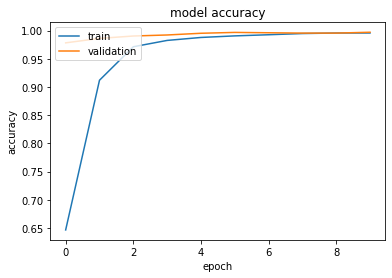

In [ ]:
plt.plot(model.history.history['accuracy'])
plt.plot(model.history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

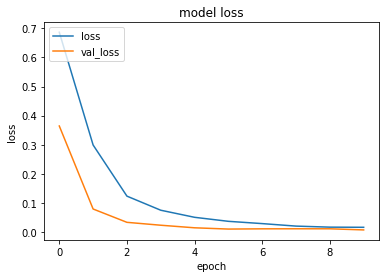

In [ ]:
plt.plot(model.history.history['loss'])
plt.plot(model.history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['loss', 'val_loss'], loc='upper left')
plt.show()

# Prediction

In [ ]:
dir_path = '/content/drive/MyDrive/data_fix_angle_augmented/test'

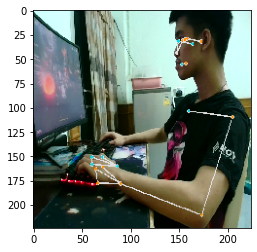

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_correct_85.png


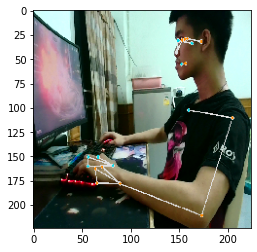

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_correct_86.png


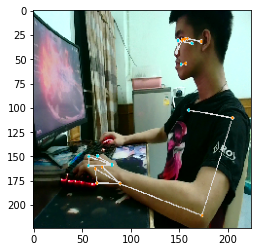

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_correct_87.png


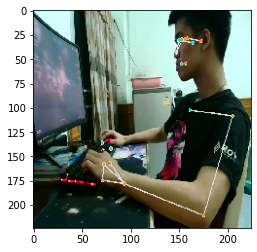

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_correct_88.png


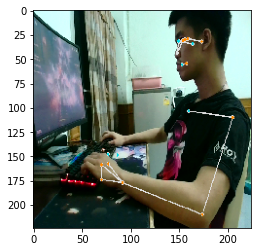

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_correct_91.png


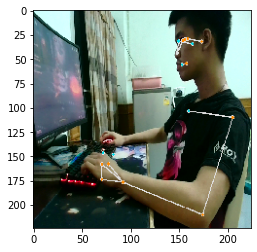

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_correct_90.png


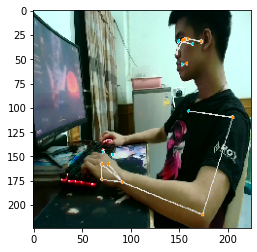

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_correct_89.png


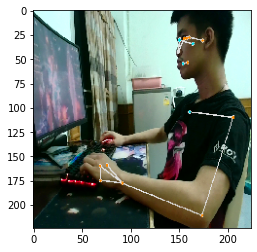

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_correct_92.png


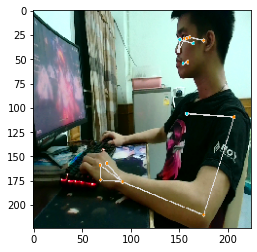

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_correct_93.png


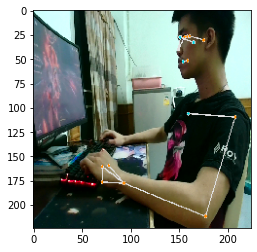

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_correct_94.png


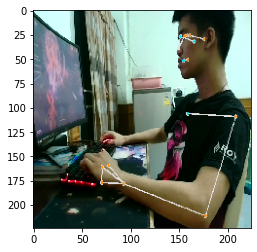

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_correct_95.png


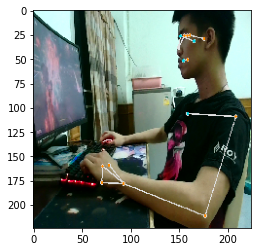

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_correct_96.png


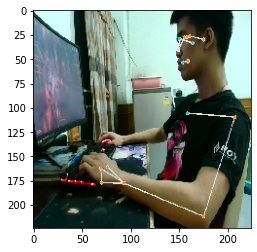

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_correct_97.png


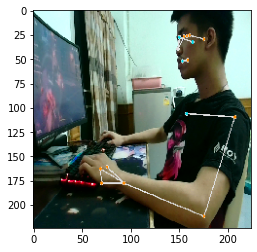

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_correct_98.png


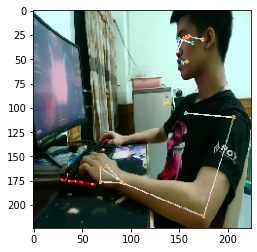

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_correct_99.png


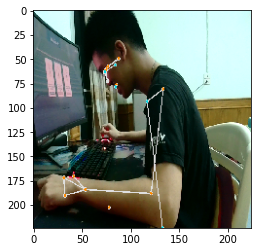

model prediction : incorrect
0.0
1.0
[[0. 1.]] kridsanapong_incorrect_85.png


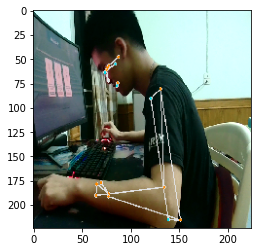

model prediction : incorrect
0.0
1.0
[[0. 1.]] kridsanapong_incorrect_86.png


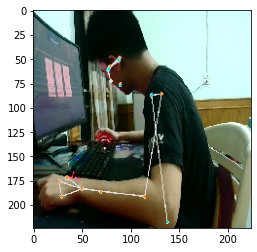

model prediction : incorrect
0.0
1.0
[[0. 1.]] kridsanapong_incorrect_87.png


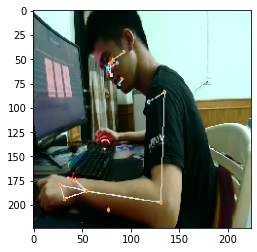

model prediction : incorrect
0.0
1.0
[[0. 1.]] kridsanapong_incorrect_88.png


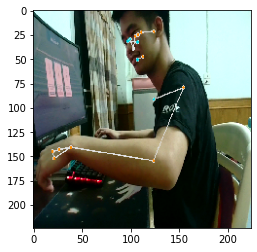

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_incorrect_89.png


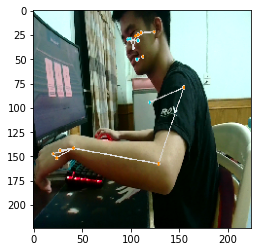

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_incorrect_90.png


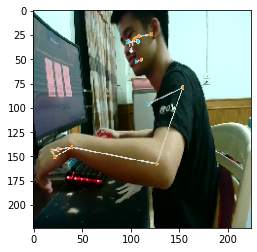

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_incorrect_91.png


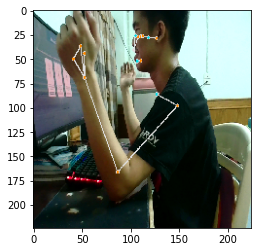

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_incorrect_95.png


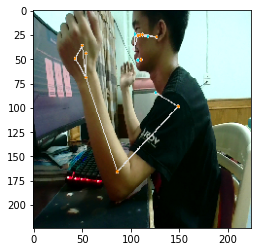

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_incorrect_94.png


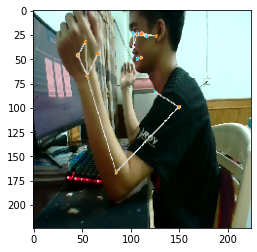

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_incorrect_92.png


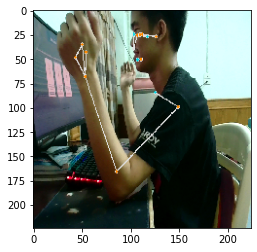

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_incorrect_93.png


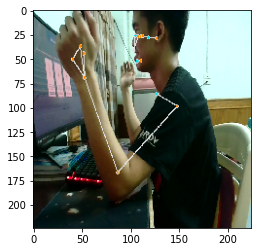

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong_incorrect_96.png


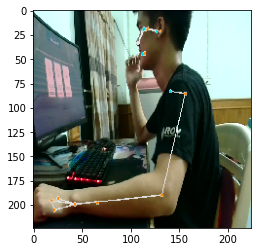

model prediction : incorrect
0.0
1.0
[[0. 1.]] kridsanapong_incorrect_97.png


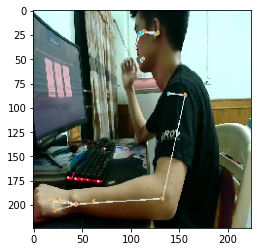

model prediction : correct
1.0
1.3756394372875635e-33
[[1.0000000e+00 1.3756394e-33]] kridsanapong_incorrect_99.png


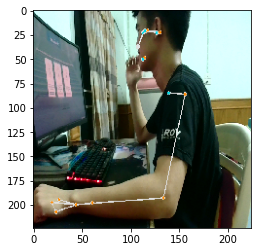

model prediction : incorrect
0.0
1.0
[[0. 1.]] kridsanapong_incorrect_98.png


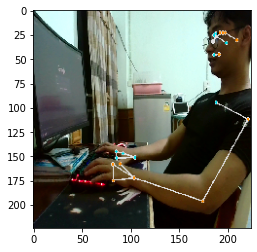

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_correct_90.png


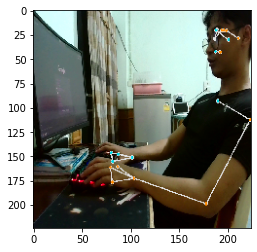

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_correct_91.png


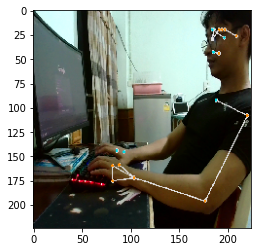

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_correct_94.png


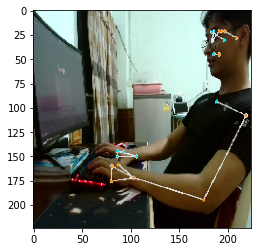

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_correct_92.png


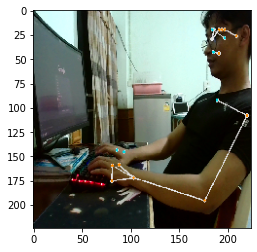

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_correct_93.png


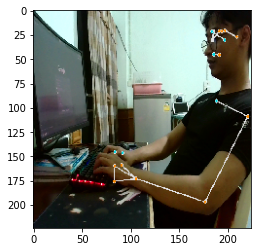

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_correct_95.png


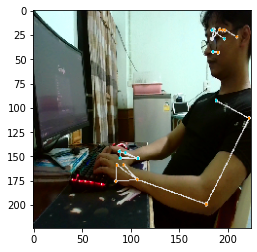

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_correct_96.png


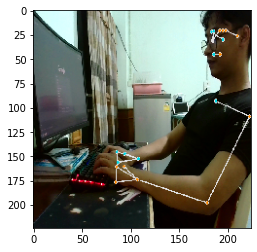

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_correct_97.png


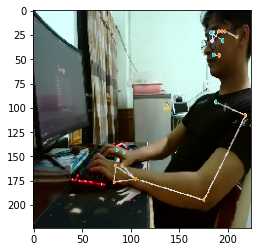

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_correct_98.png


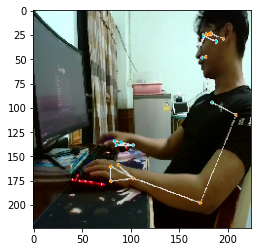

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_correct_100.png


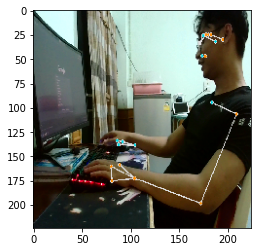

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_correct_101.png


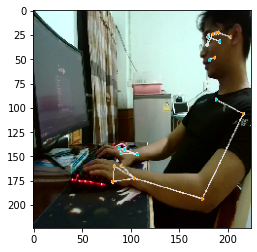

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_correct_99.png


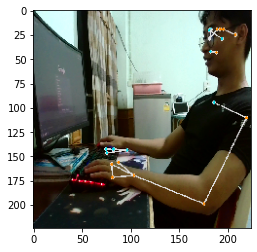

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_correct_102.png


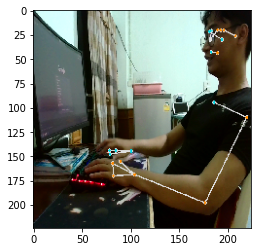

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_correct_103.png


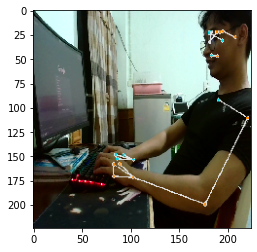

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_correct_104.png


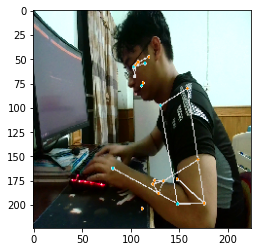

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_incorrect_85.png


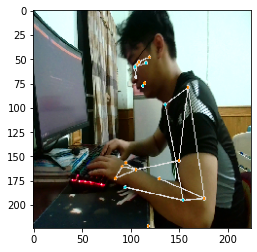

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_incorrect_86.png


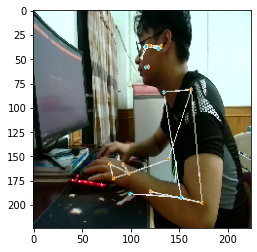

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_incorrect_87.png


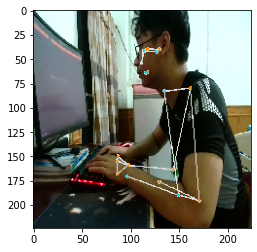

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_incorrect_88.png


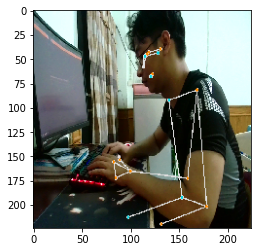

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_incorrect_89.png


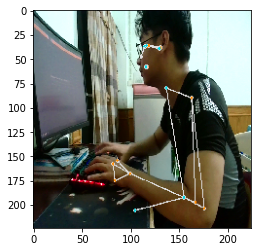

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_incorrect_91.png


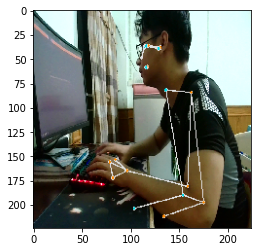

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_incorrect_90.png


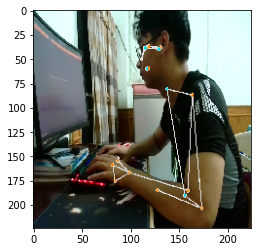

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_incorrect_92.png


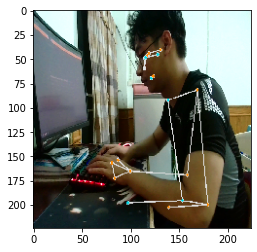

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_incorrect_93.png


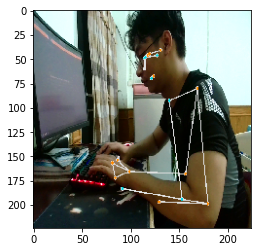

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_incorrect_94.png


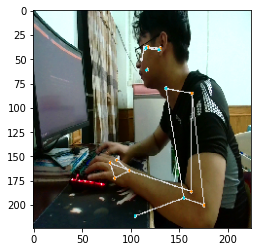

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_incorrect_95.png


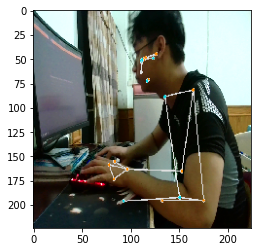

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_incorrect_96.png


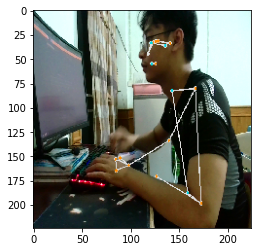

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_incorrect_97.png


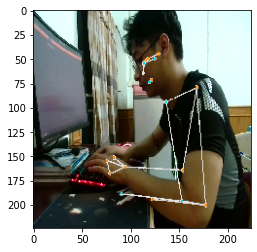

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_incorrect_98.png


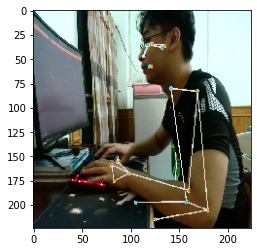

model prediction : correct
1.0
0.0
[[1. 0.]] sek_at_jamesRoom_incorrect_99.png


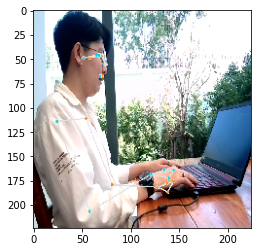

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_correct_85.png


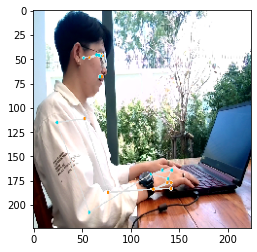

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_correct_87.png


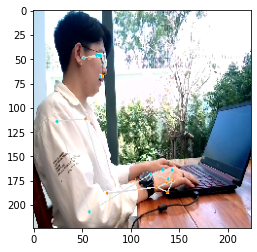

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_correct_86.png


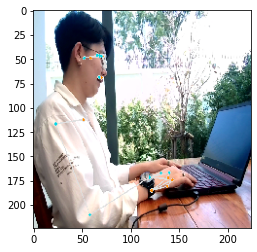

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_correct_89.png


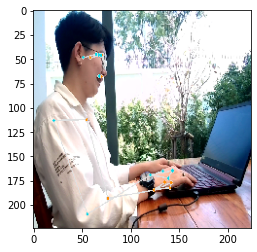

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_correct_88.png


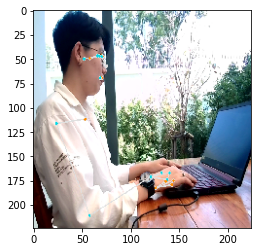

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_correct_90.png


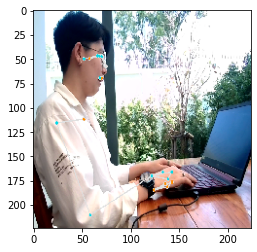

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_correct_91.png


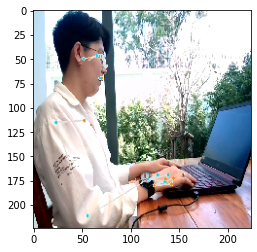

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_correct_92.png


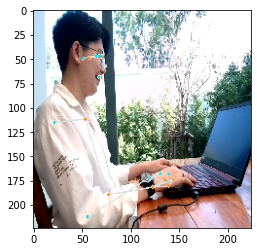

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_correct_93.png


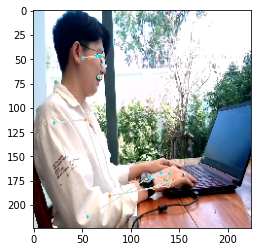

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_correct_94.png


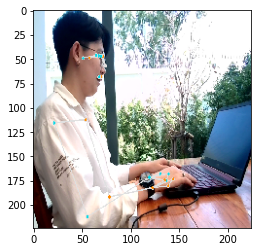

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_correct_95.png


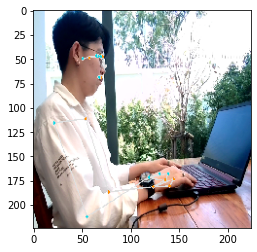

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_correct_96.png


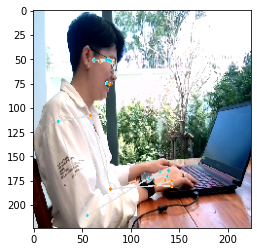

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_correct_98.png


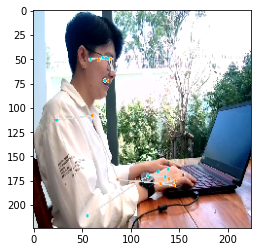

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_correct_97.png


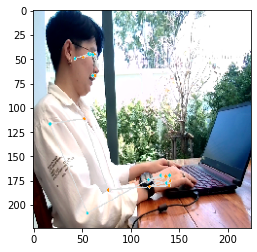

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_correct_99.png


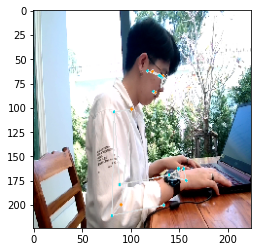

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_incorrect_85.png


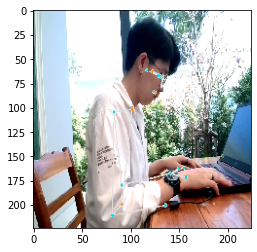

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_incorrect_86.png


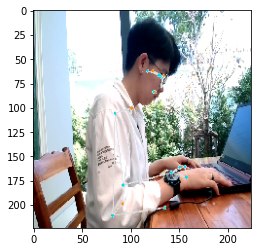

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_incorrect_88.png


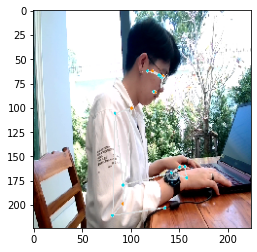

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_incorrect_89.png


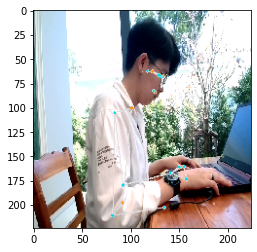

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_incorrect_87.png


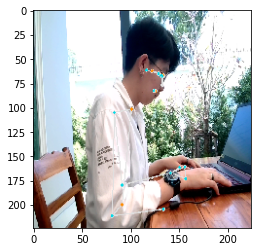

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_incorrect_90.png


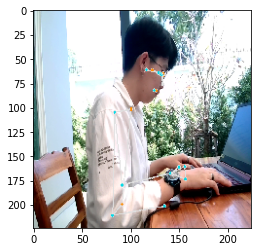

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_incorrect_91.png


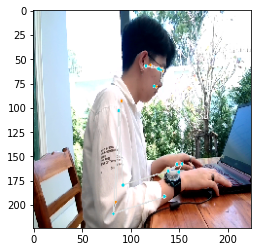

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_incorrect_92.png


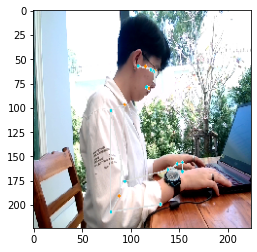

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_incorrect_93.png


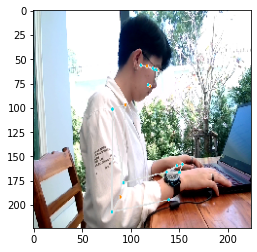

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_incorrect_94.png


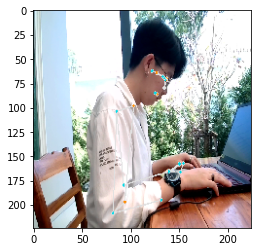

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_incorrect_95.png


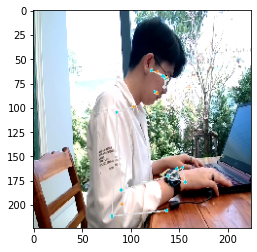

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_incorrect_96.png


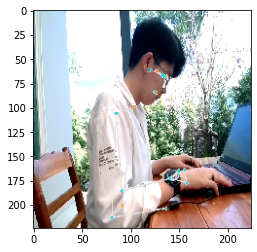

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_incorrect_97.png


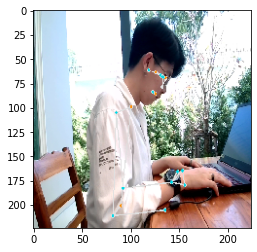

model prediction : correct
1.0
2.3429586560830572e-36
[[1.0000000e+00 2.3429587e-36]] Pjo_incorrect_99.png


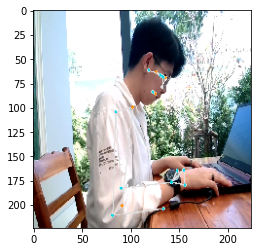

model prediction : correct
1.0
0.0
[[1. 0.]] Pjo_incorrect_98.png


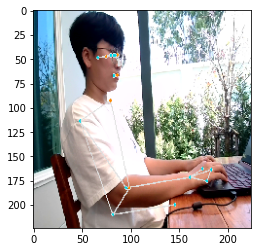

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_correct_85.png


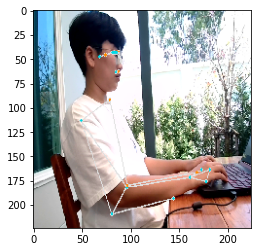

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_correct_86.png


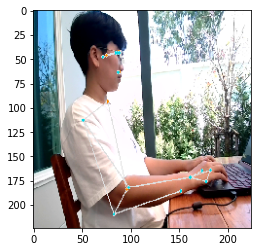

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_correct_87.png


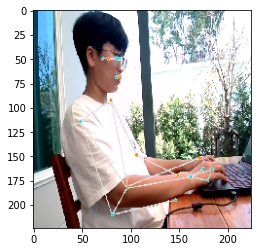

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_correct_88.png


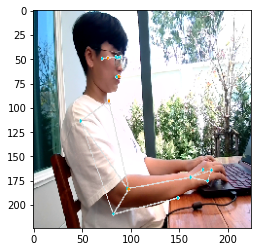

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_correct_89.png


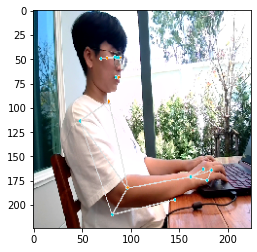

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_correct_91.png


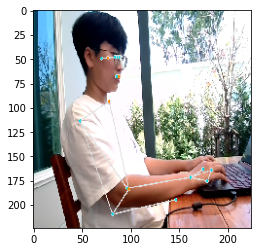

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_correct_90.png


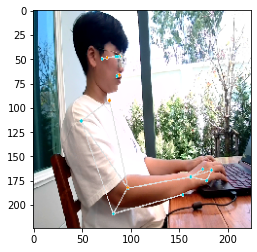

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_correct_92.png


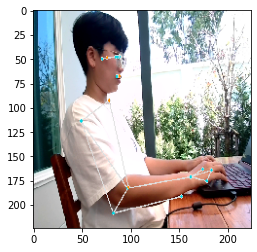

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_correct_93.png


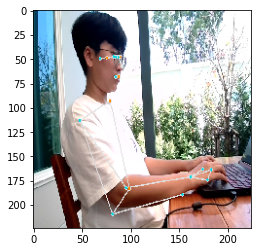

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_correct_94.png


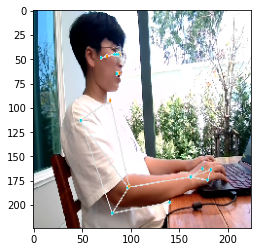

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_correct_96.png


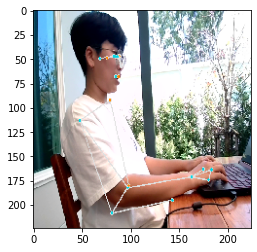

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_correct_95.png


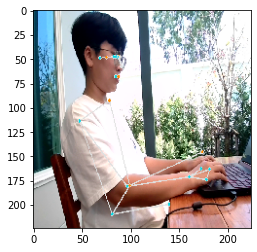

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_correct_97.png


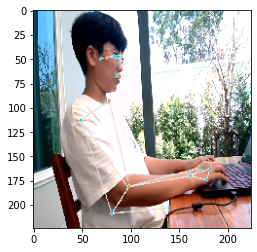

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_correct_98.png


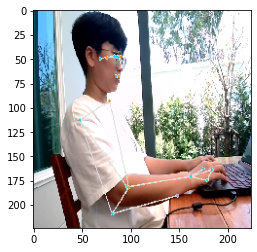

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_correct_99.png


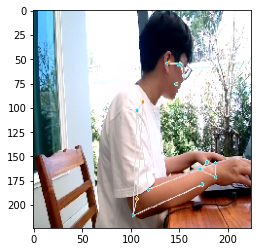

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_incorrect_85.png


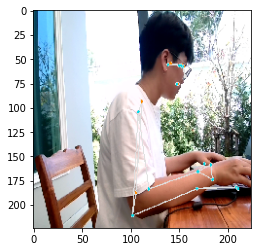

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_incorrect_86.png


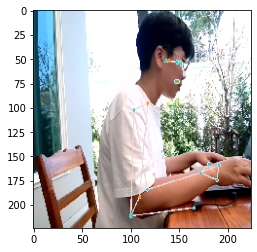

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_incorrect_87.png


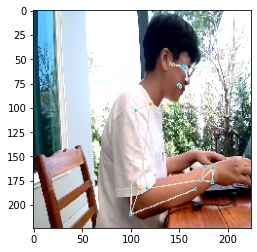

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_incorrect_88.png


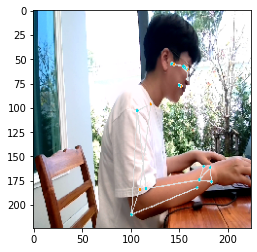

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_incorrect_89.png


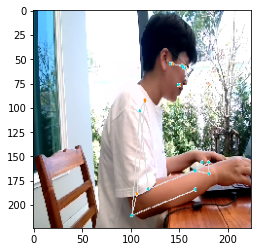

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_incorrect_91.png


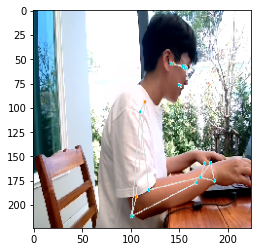

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_incorrect_90.png


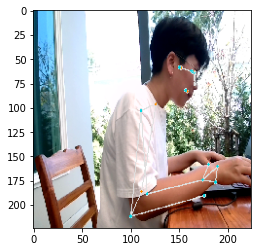

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_incorrect_92.png


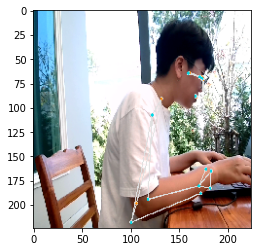

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_incorrect_93.png


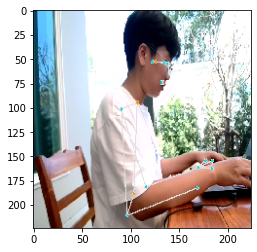

model prediction : incorrect
0.0
1.0
[[0. 1.]] PBoung_incorrect_94.png


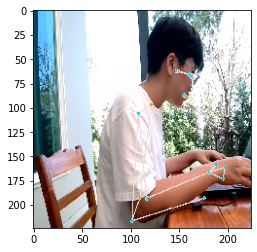

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_incorrect_95.png


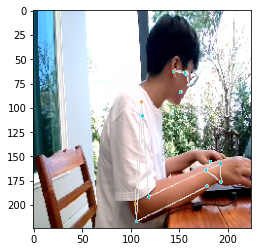

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_incorrect_96.png


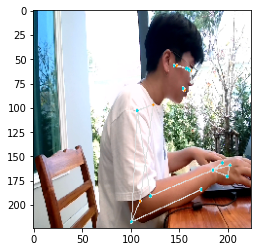

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_incorrect_97.png


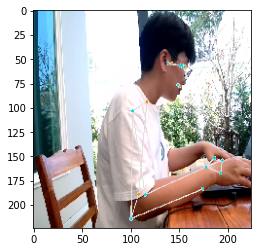

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_incorrect_98.png


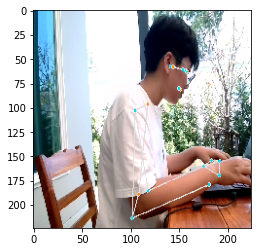

model prediction : correct
1.0
0.0
[[1. 0.]] PBoung_incorrect_99.png


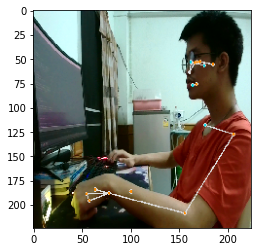

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_correct_88.png


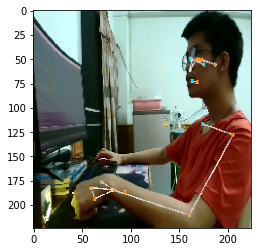

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_correct_90.png


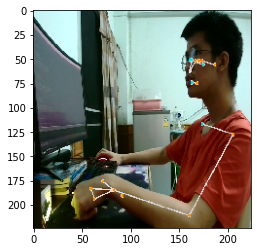

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_correct_89.png


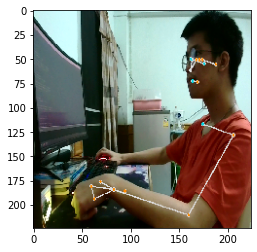

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_correct_91.png


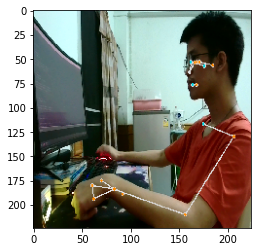

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_correct_92.png


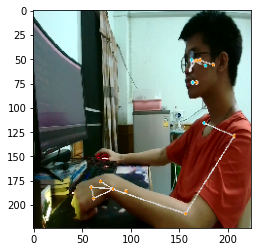

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_correct_93.png


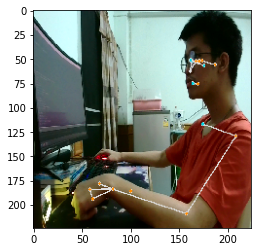

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_correct_94.png


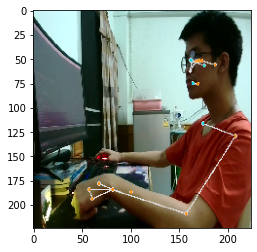

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_correct_95.png


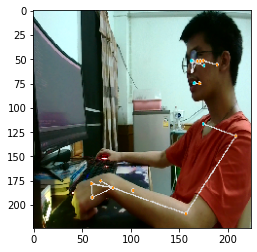

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_correct_96.png


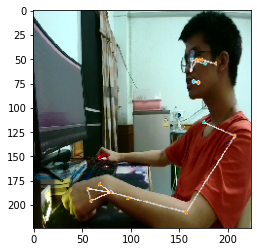

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_correct_97.png


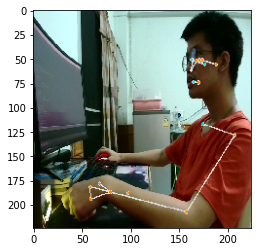

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_correct_98.png


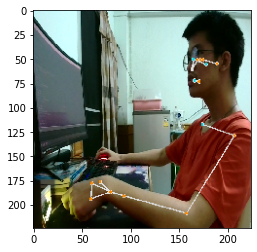

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_correct_99.png


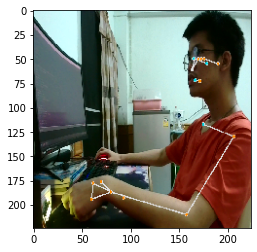

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_correct_100.png


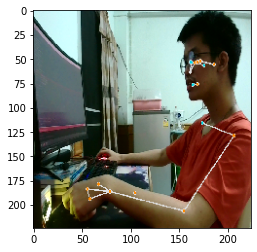

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_correct_101.png


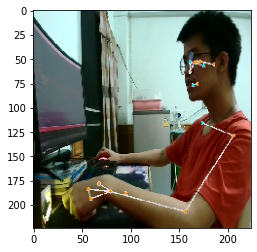

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_correct_102.png


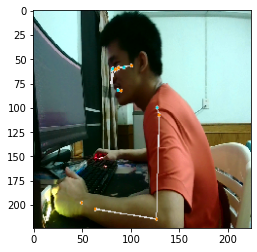

model prediction : incorrect
0.0
1.0
[[0. 1.]] kridsanapong2nd_incorrect_85.png


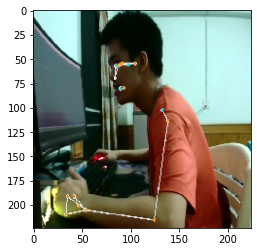

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_incorrect_86.png


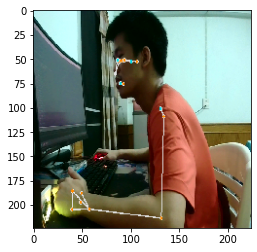

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_incorrect_87.png


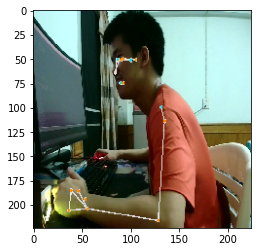

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_incorrect_88.png


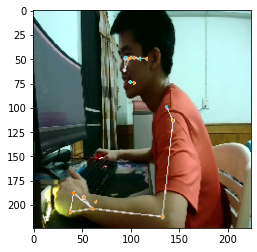

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_incorrect_89.png


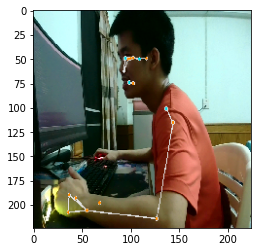

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_incorrect_90.png


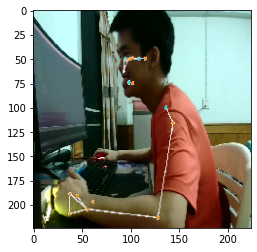

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_incorrect_91.png


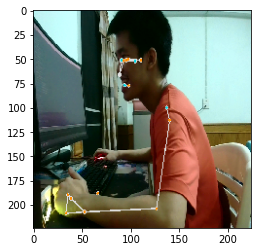

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_incorrect_92.png


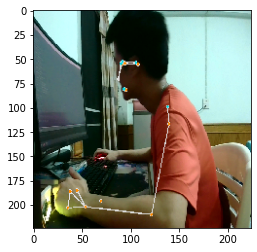

model prediction : incorrect
0.0
1.0
[[0. 1.]] kridsanapong2nd_incorrect_93.png


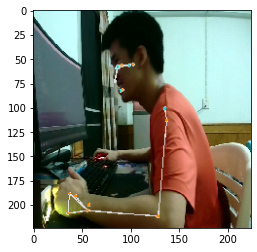

model prediction : incorrect
0.0
1.0
[[0. 1.]] kridsanapong2nd_incorrect_94.png


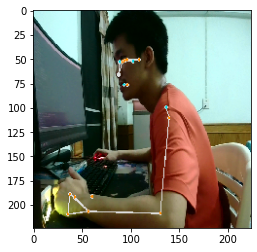

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_incorrect_95.png


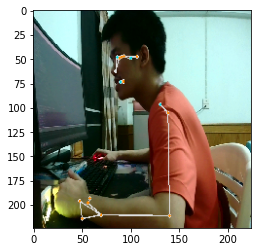

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_incorrect_96.png


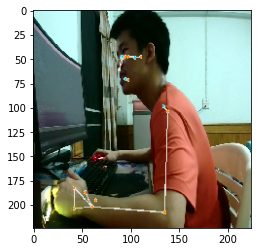

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_incorrect_97.png


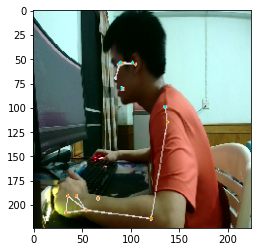

model prediction : correct
1.0
1.509576491587339e-11
[[1.0000000e+00 1.5095765e-11]] kridsanapong2nd_incorrect_98.png


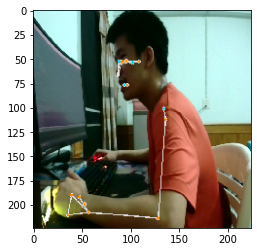

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong2nd_incorrect_99.png


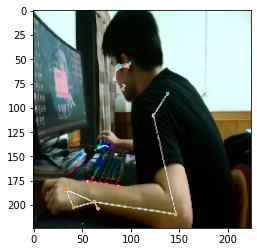

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_incorrect_85.png


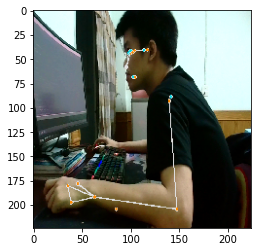

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_incorrect_87.png


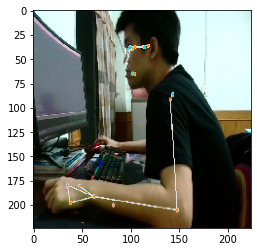

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_incorrect_86.png


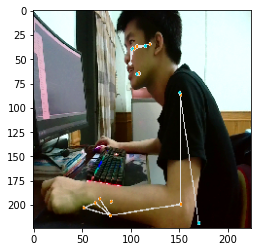

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_incorrect_88.png


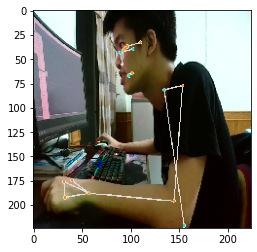

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_incorrect_90.png


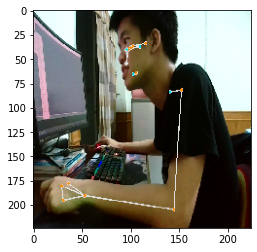

model prediction : incorrect
6.458566122972659e-20
1.0
[[6.458566e-20 1.000000e+00]] kridsanapong3nd_incorrect_89.png


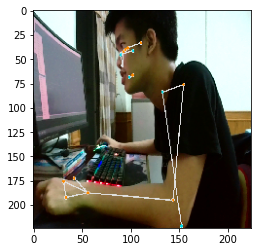

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_incorrect_91.png


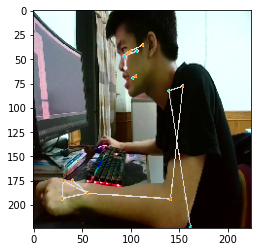

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_incorrect_93.png


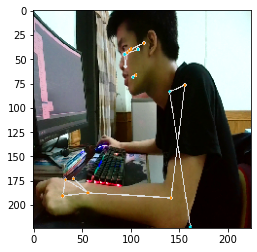

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_incorrect_92.png


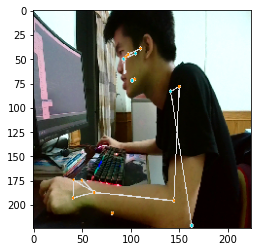

model prediction : incorrect
0.0
1.0
[[0. 1.]] kridsanapong3nd_incorrect_94.png


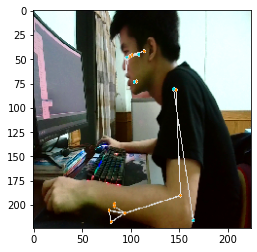

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_incorrect_95.png


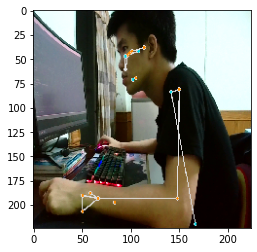

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_incorrect_96.png


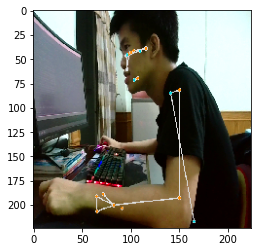

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_incorrect_97.png


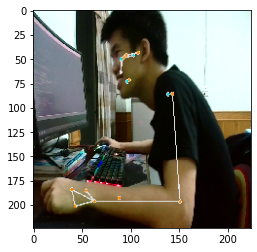

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_incorrect_98.png


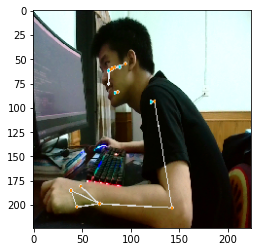

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_incorrect_99.png


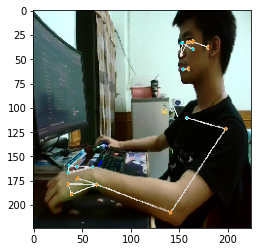

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_correct_85.png


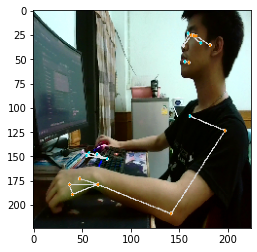

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_correct_86.png


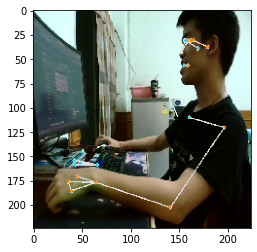

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_correct_87.png


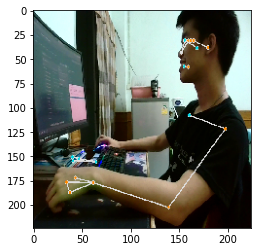

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_correct_88.png


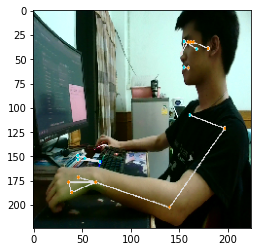

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_correct_89.png


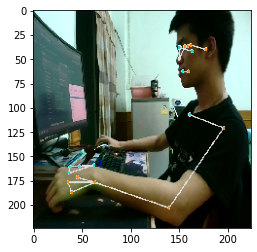

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_correct_90.png


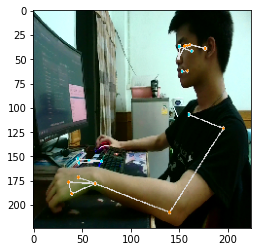

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_correct_92.png


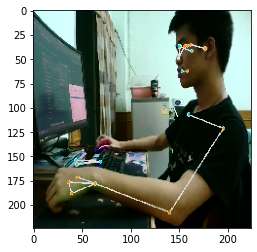

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_correct_91.png


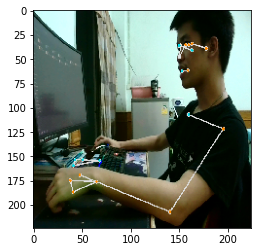

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_correct_93.png


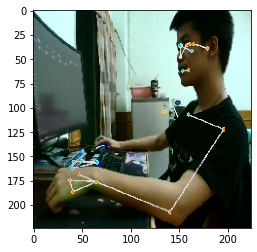

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_correct_94.png


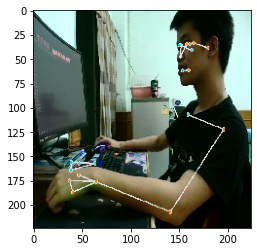

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_correct_95.png


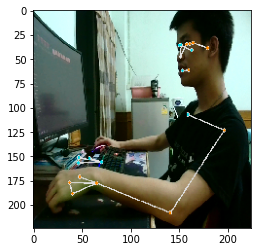

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_correct_96.png


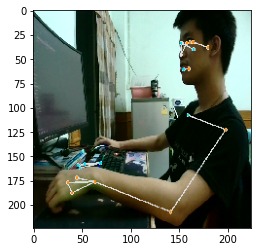

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_correct_97.png


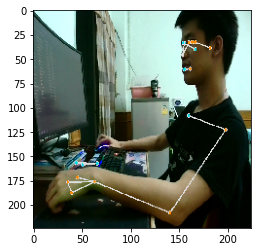

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_correct_98.png


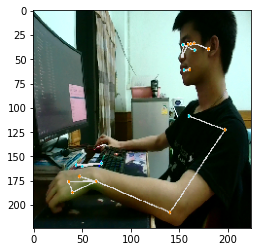

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong3nd_correct_99.png


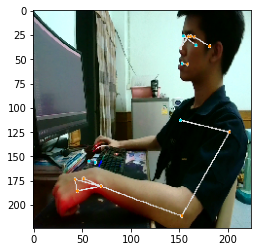

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_correct_85.png


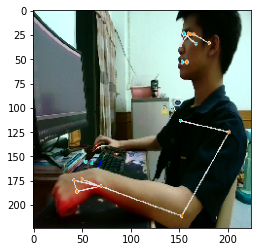

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_correct_86.png


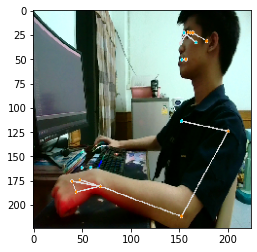

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_correct_87.png


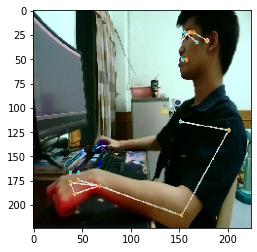

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_correct_88.png


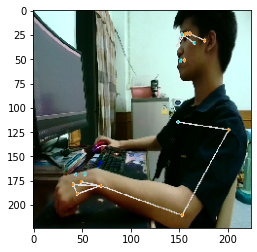

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_correct_89.png


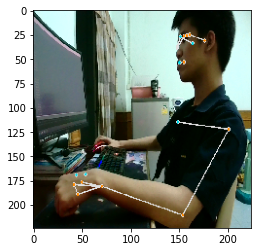

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_correct_90.png


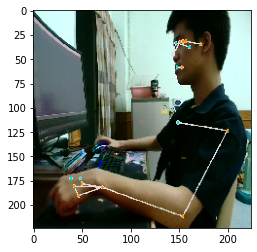

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_correct_91.png


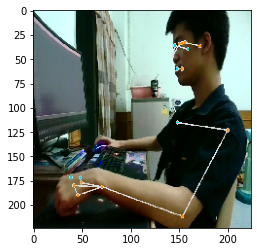

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_correct_92.png


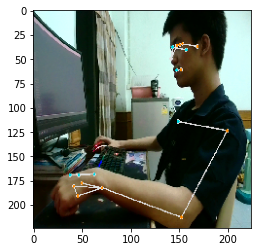

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_correct_93.png


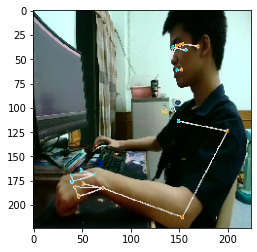

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_correct_94.png


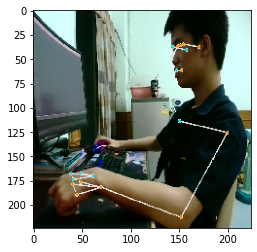

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_correct_96.png


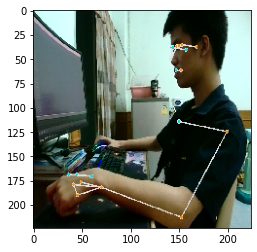

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_correct_95.png


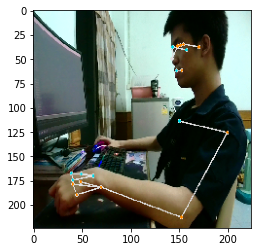

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_correct_97.png


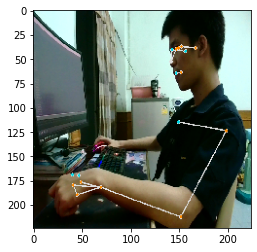

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_correct_98.png


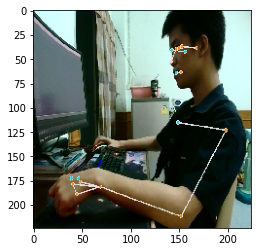

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_correct_99.png


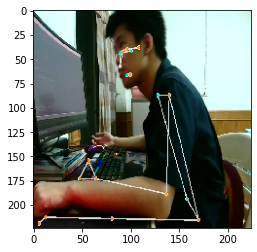

model prediction : incorrect
1.1514891992659652e-15
1.0
[[1.1514892e-15 1.0000000e+00]] kridsanapong4nd_incorrect_85.png


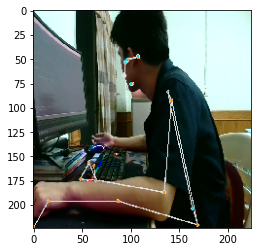

model prediction : incorrect
7.628156397663396e-28
1.0
[[7.6281564e-28 1.0000000e+00]] kridsanapong4nd_incorrect_86.png


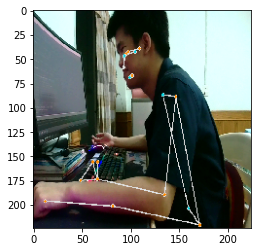

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_incorrect_88.png


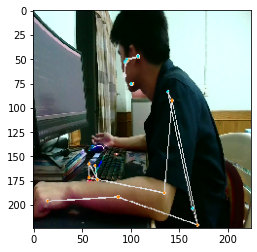

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_incorrect_87.png


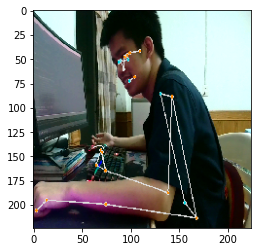

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_incorrect_89.png


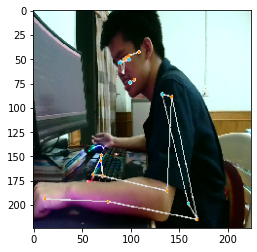

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_incorrect_91.png


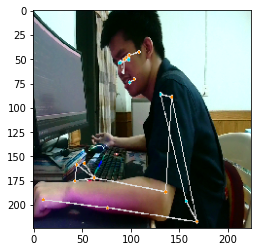

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_incorrect_90.png


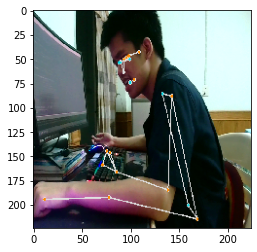

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_incorrect_92.png


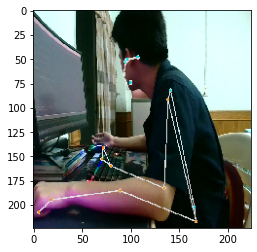

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_incorrect_93.png


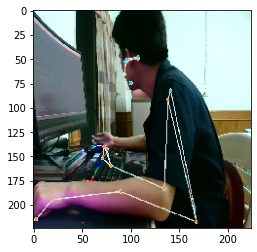

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_incorrect_94.png


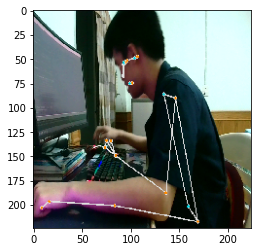

model prediction : incorrect
0.0
1.0
[[0. 1.]] kridsanapong4nd_incorrect_95.png


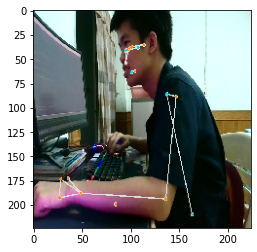

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_incorrect_96.png


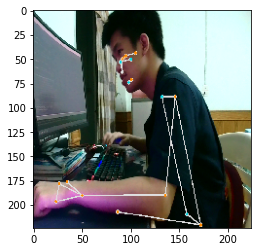

model prediction : correct
1.0
0.0
[[1. 0.]] kridsanapong4nd_incorrect_97.png


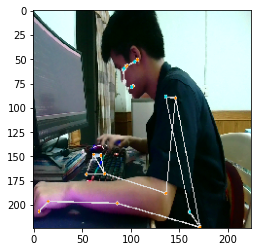

model prediction : incorrect
0.0
1.0
[[0. 1.]] kridsanapong4nd_incorrect_99.png


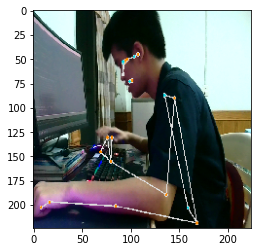

model prediction : correct
1.0
1.006362987919162e-17
[[1.000000e+00 1.006363e-17]] kridsanapong4nd_incorrect_98.png


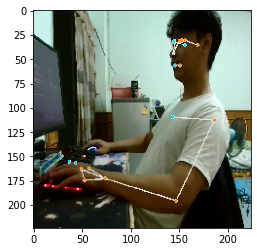

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_170.png


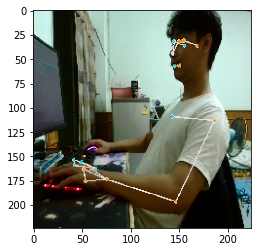

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_171.png


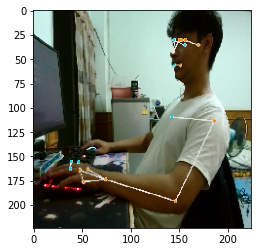

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_172.png


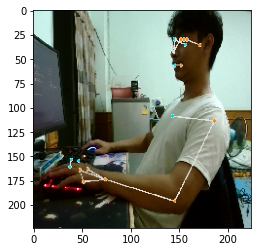

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_173.png


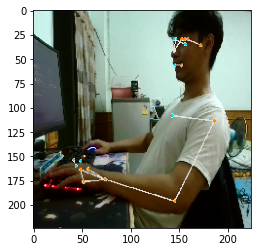

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_174.png


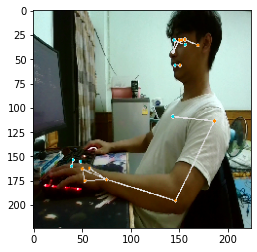

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_175.png


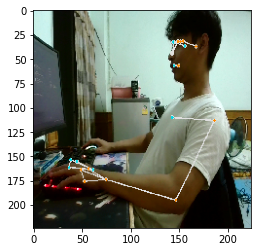

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_176.png


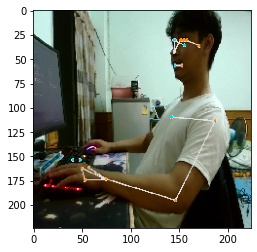

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_177.png


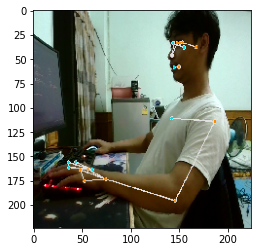

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_178.png


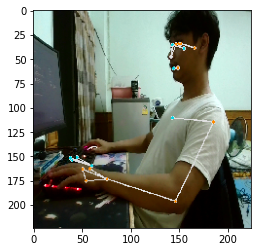

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_179.png


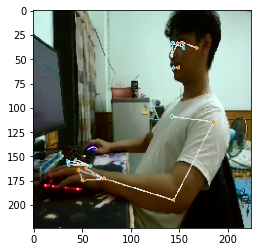

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_180.png


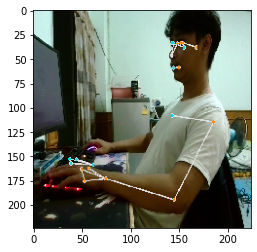

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_181.png


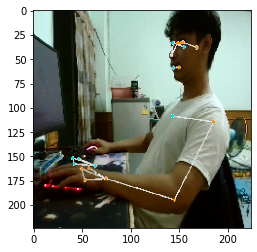

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_182.png


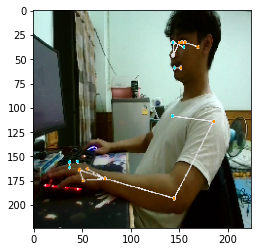

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_183.png


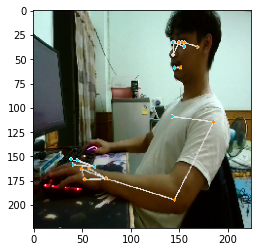

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_184.png


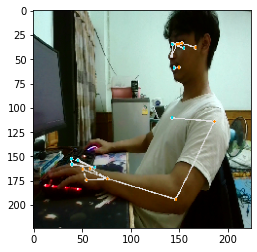

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_185.png


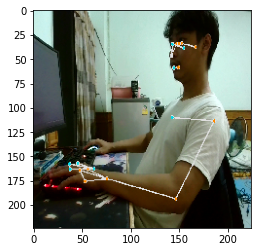

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_187.png


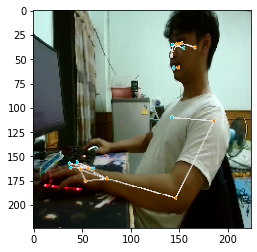

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_186.png


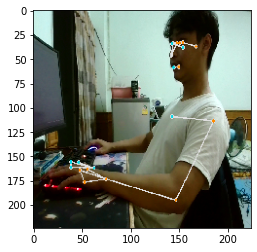

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_188.png


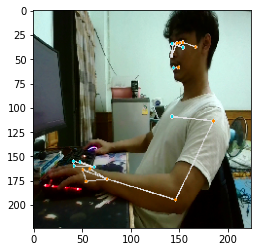

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_189.png


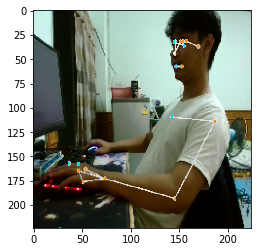

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_190.png


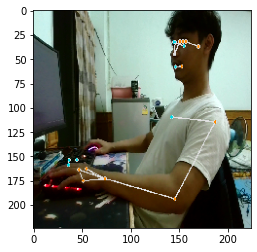

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_191.png


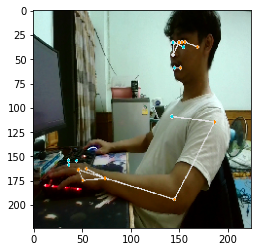

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_192.png


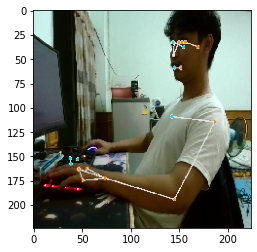

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_193.png


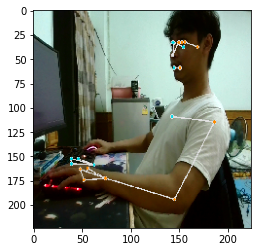

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_194.png


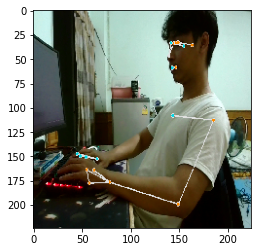

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_196.png


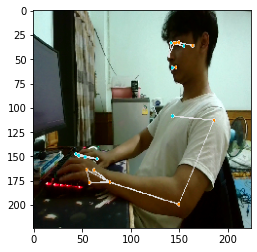

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_195.png


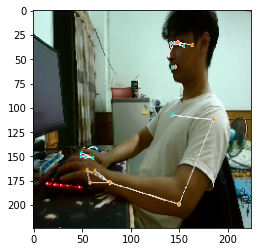

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_197.png


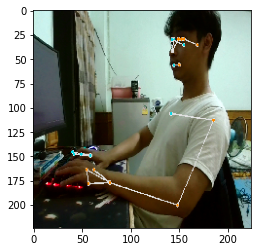

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_198.png


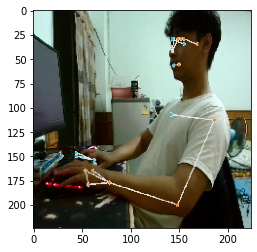

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_correct_199.png


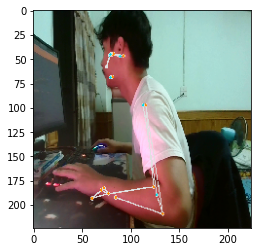

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_incorrect_170.png


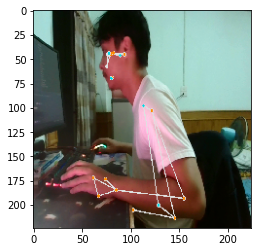

model prediction : incorrect
0.0
1.0
[[0. 1.]] sekson2nd_incorrect_171.png


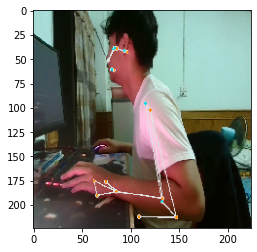

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_incorrect_172.png


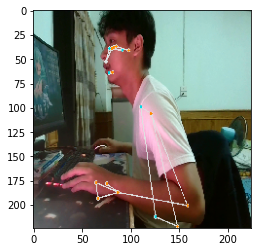

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_incorrect_173.png


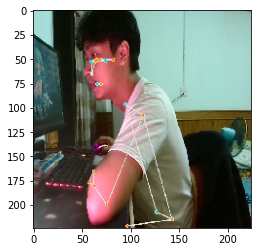

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_incorrect_174.png


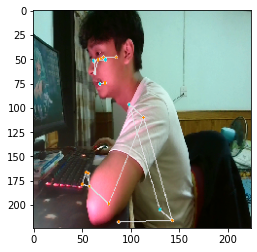

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_incorrect_175.png


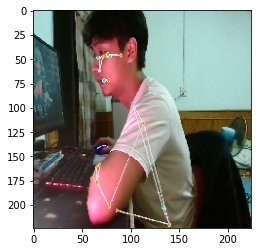

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_incorrect_176.png


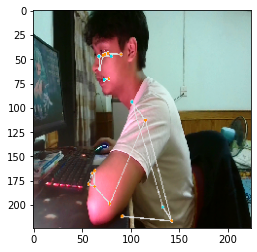

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_incorrect_177.png


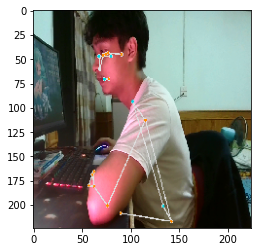

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_incorrect_178.png


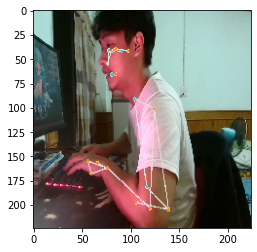

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_incorrect_179.png


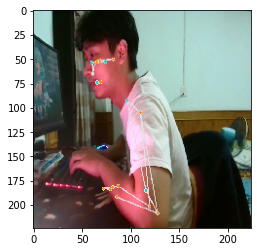

model prediction : correct
1.0
2.496073315239155e-37
[[1.0000000e+00 2.4960733e-37]] sekson2nd_incorrect_180.png


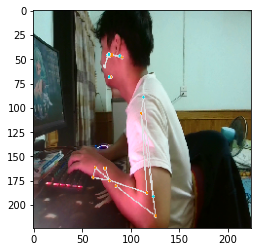

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_incorrect_182.png


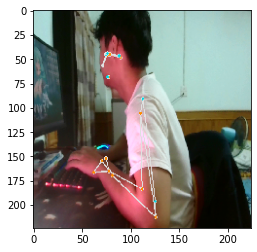

model prediction : correct
1.0
4.723359057564214e-16
[[1.000000e+00 4.723359e-16]] sekson2nd_incorrect_181.png


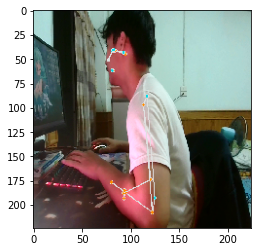

model prediction : incorrect
0.0
1.0
[[0. 1.]] sekson2nd_incorrect_183.png


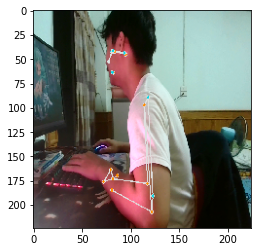

model prediction : incorrect
0.0
1.0
[[0. 1.]] sekson2nd_incorrect_184.png


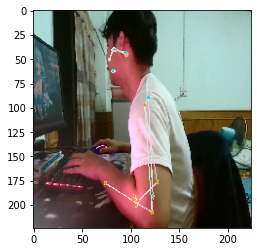

model prediction : incorrect
4.534912064069547e-24
1.0
[[4.534912e-24 1.000000e+00]] sekson2nd_incorrect_185.png


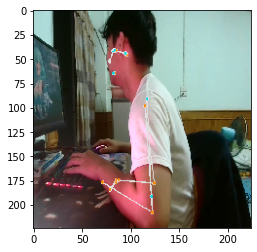

model prediction : incorrect
0.0
1.0
[[0. 1.]] sekson2nd_incorrect_186.png


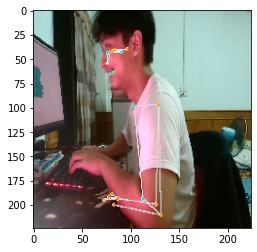

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_incorrect_189.png


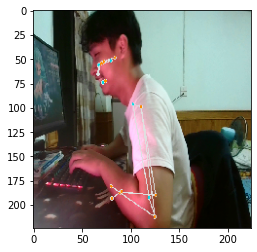

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_incorrect_187.png


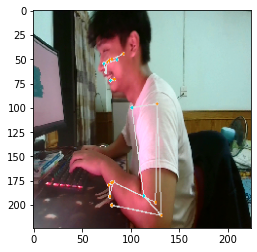

model prediction : incorrect
6.411724484678416e-07
0.9999994039535522
[[6.4117245e-07 9.9999940e-01]] sekson2nd_incorrect_188.png


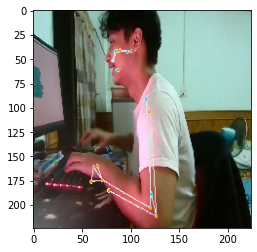

model prediction : correct
1.0
2.5862600388708172e-33
[[1.00000e+00 2.58626e-33]] sekson2nd_incorrect_190.png


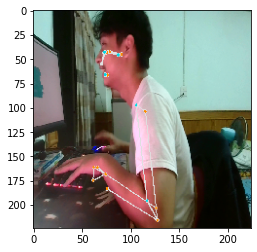

model prediction : incorrect
1.759300721460022e-05
0.9999823570251465
[[1.7593007e-05 9.9998236e-01]] sekson2nd_incorrect_191.png


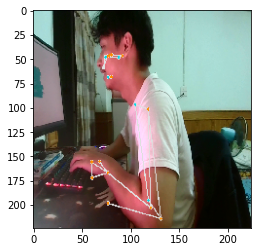

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_incorrect_192.png


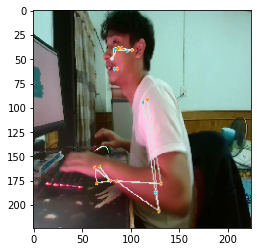

model prediction : incorrect
0.0
1.0
[[0. 1.]] sekson2nd_incorrect_193.png


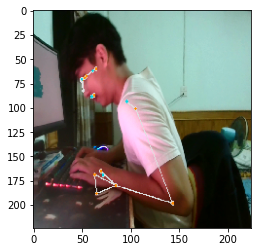

model prediction : incorrect
0.0
1.0
[[0. 1.]] sekson2nd_incorrect_194.png


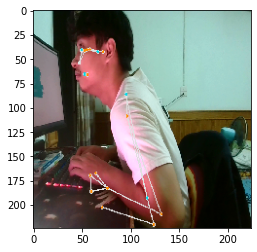

model prediction : incorrect
0.0
1.0
[[0. 1.]] sekson2nd_incorrect_195.png


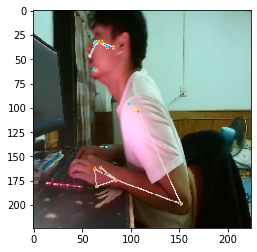

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_incorrect_196.png


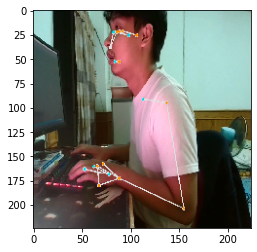

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_incorrect_198.png


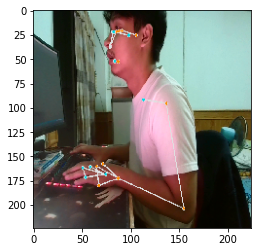

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_incorrect_197.png


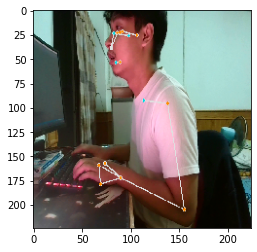

model prediction : correct
1.0
0.0
[[1. 0.]] sekson2nd_incorrect_199.png


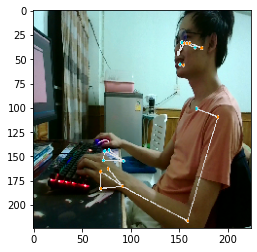

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_correct_88.png


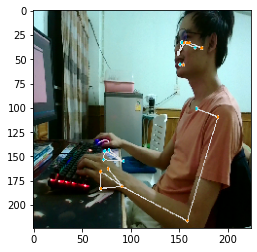

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_correct_87.png


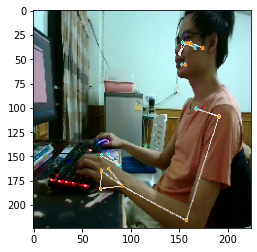

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_correct_85.png


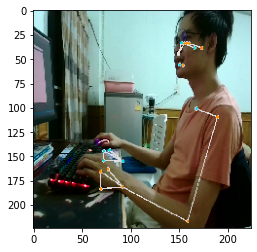

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_correct_89.png


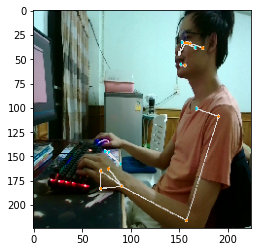

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_correct_86.png


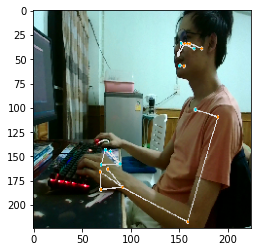

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_correct_90.png


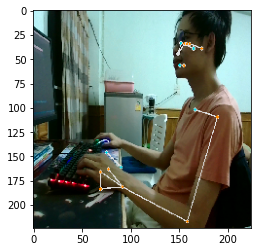

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_correct_92.png


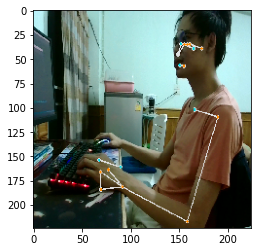

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_correct_91.png


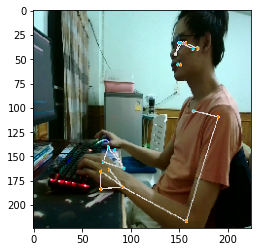

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_correct_94.png


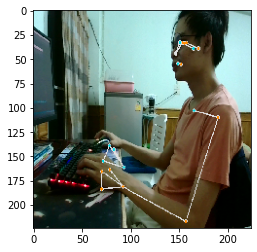

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_correct_93.png


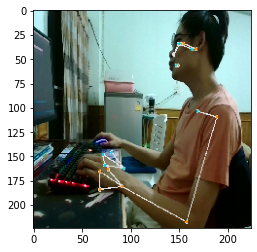

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_correct_95.png


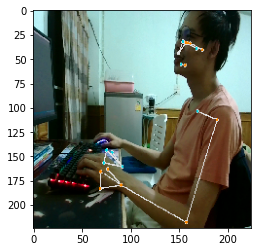

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_correct_96.png


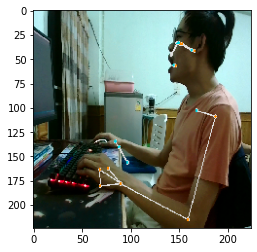

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_correct_98.png


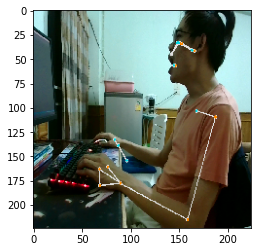

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_correct_97.png


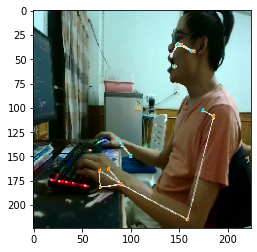

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_correct_99.png


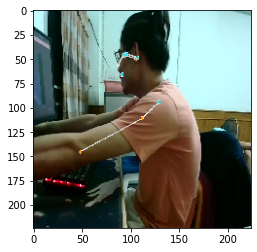

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_incorrect_85.png


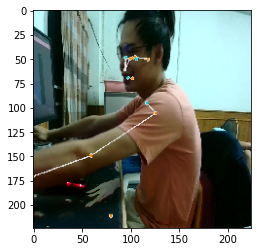

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_incorrect_86.png


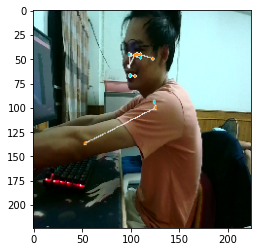

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_incorrect_87.png


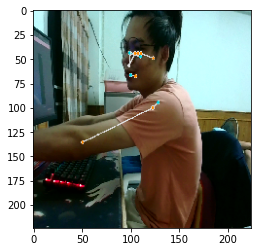

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_incorrect_88.png


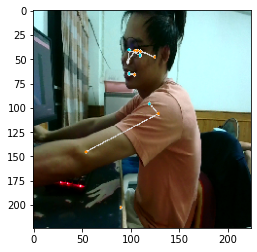

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_incorrect_89.png


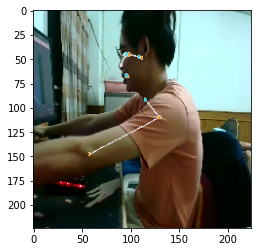

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_incorrect_90.png


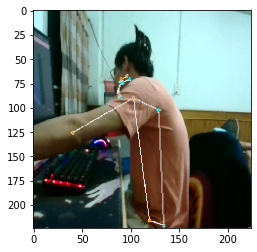

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_incorrect_91.png


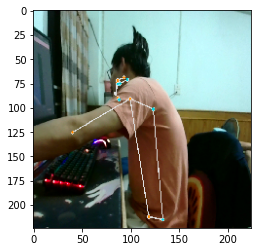

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_incorrect_92.png


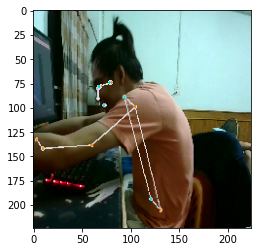

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_incorrect_93.png


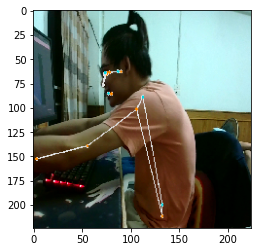

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_incorrect_94.png


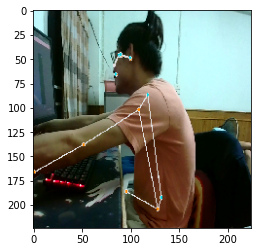

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_incorrect_95.png


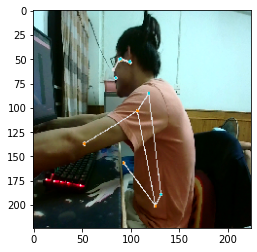

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_incorrect_96.png


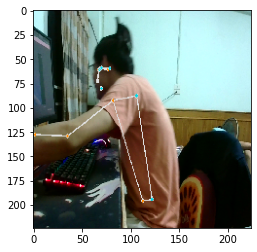

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_incorrect_97.png


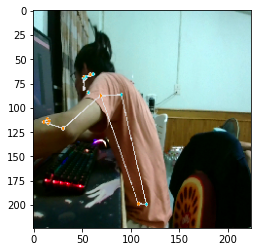

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_incorrect_98.png


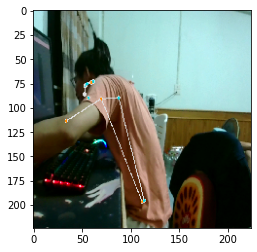

model prediction : correct
1.0
0.0
[[1. 0.]] chatchai_incorrect_99.png


In [ ]:
correct =0
incorrect =0
total =0

TruePositive=0   #ทายว่า correct ออกมาเป็น corect
TrueNegative=0  #ทายว่า incorrect ออมาเป็น incorect
FalsePositive=0  #ทายว่า correct แต่ออกมาเป็น incorrect
FalseNegative=0  #ทายว่า incorrect แต่ออกมาเป็น correct

for i in os.listdir(dir_path):
    img = tf.keras.preprocessing.image.load_img(dir_path+'//'+i, target_size=(224,224))
    plt.imshow(img)
    plt.show()

    X= tf.keras.preprocessing.image.img_to_array(img)
    X= np.expand_dims(X,axis=0)
    image = np.vstack([X])
    val = model.predict(image)

    #correct > incorrect
    if float(val[0][0]) > float(val[0][1]):
        total +=1
        if 'in' in i:
            incorrect +=1
            FalsePositive +=1
            
        else:
            correct +=1
            TruePositive +=1
        print('model prediction : correct')

    #incorrect > correct
    elif float(val[0][0]) < float(val[0][1]):
        total +=1
        if 'in' in i:
          correct +=1
          TrueNegative +=1
        else:
          incorrect +=1
          FalseNegative +=1
        print('model prediction : incorrect')  

    
    print(float(val[0][0]))
    print(float(val[0][1]))
    print(val,i)

In [ ]:
print(val)
print(val[0][0])
print(val[0][1])

[[1. 0.]]
1.0
0.0


In [ ]:
print(correct)
print(incorrect)

176
124


# Accuracy conclusion

In [ ]:
print('correct  : {:.2%}'.format(correct/total))
print('incorrect: {:.2%}'.format(incorrect/total))

correct  : 58.67%
incorrect: 41.33%


In [ ]:
print('actual : ', total)
print('true positive : ', TruePositive)
print('true negative : ', TrueNegative)
print('false positive : ', FalsePositive)
print('false negative : ', FalseNegative)

actual :  300
true positive :  150
true negative :  26
false positive :  124
false negative :  0


In [ ]:
!pip install line-bot-sdk

     |████████████████████████████████| 87 kB 5.2 MB/s 
     |████████████████████████████████| 1.1 MB 22.8 MB/s 
     |████████████████████████████████| 271 kB 69.1 MB/s 
     |████████████████████████████████| 144 kB 67.2 MB/s 
     |████████████████████████████████| 94 kB 3.5 MB/s 


In [ ]:
from linebot import LineBotApi
from linebot.models import TextSendMessage
from linebot.exceptions import LineBotApiError

line_bot_api = LineBotApi('ZRjyjNwSVRqlhznKRP7Ls7IUV8pgmyUxdGnBGMfEf6teuPM+qtWQg8BuOwnsUUAEC6h7RRTRssYO4Gt2NguYF7etzhJiU0JBWZdfdAbIkFxHalnIumMN/8710BIrVnn3Xj7NxjcHkbq8I8b20s36VQdB04t89/1O/w1cDnyilFU=')

# Precision & Recall
ของการตรวจท่าที่ถูก

In [ ]:
try:
    preCor = TruePositive/(TruePositive+FalsePositive)
    reCor = TruePositive/(TruePositive+FalseNegative)
    f1Cor = 2*((preCor*reCor)/(preCor+reCor))
    print('precision : ', preCor)
    print('recall    : ', reCor)
    print('f1        : ', f1Cor)
    
except ZeroDivisionError as e:
    # error handle
    exc = str(e)
    line_bot_api.push_message('Ua8dbc2f97b9014c36aac262f1a8bd285', TextSendMessage(text='Error!! '+exc))
    print(exc)

precision :  0.5474452554744526
recall    :  1.0
f1        :  0.7075471698113208


# Precision & Recall
ของการตรวจท่าที่ผิด

In [ ]:
try:
    preIn = TrueNegative/(TrueNegative+FalseNegative)
    reIn = TrueNegative/(TrueNegative+FalsePositive)
    f1In = 2*((preIn*reIn)/(preIn+reIn))

    print('precision : ', preIn)
    print('recall    : ', reIn)
    print('f1        : ', f1In)
except ZeroDivisionError as e:
  # error handle
    exc = str(e)
    line_bot_api.push_message('Ua8dbc2f97b9014c36aac262f1a8bd285', TextSendMessage(text='Error!! '+exc))
    print(exc)

precision :  1.0
recall    :  0.17333333333333334
f1        :  0.29545454545454547


In [ ]:


try:
    line_bot_api.push_message('Ua8dbc2f97b9014c36aac262f1a8bd285', TextSendMessage(text='Train เสร็จแล้ว !!'))
except LineBotApiError as e:
    # error handle
    ...